#  Robotics Project : Autonomous driving and VSLAM for Turtlebot3 

* **Authors:**

    . Samer SHILI

    . Mehdi CHERIA

* **Instructors:**

    . Dr Jouquin RODRIGUEZ
    
    . Raphael DUVERNE

---

## Table of Contents
* [1. Introduction](#1-introduction)
    * [1.1. Objective](#11-objective)
* [2. Methodology](#2-methodology)
    * [2.1. Image Acquisition](#21-image-acquisition)
    * [2.2. Camera Calibration](#22-camera-calibration)
    * [2.3. Camera Calibration with Respect to the Fish-eye Camera](#23-camera-calibration-with-respect-to-the-fish-eye-camera)
    * [2.4. Intrinsic Calibration](#24-intrinsic-calibration)
        * [2.4.1. General Model](#241-general-model)
        * [2.4.2. Radial Distortion Model](#242-radial-distortion-model)
        * [2.4.3. Tangential Distortion Model](#243-tangential-distortion-model)
        * [2.4.4. Adapting for Fish-eye Camera](#244-adapting-for-fish-eye-camera)
    * [2.5. Extrinsic Calibration](#25-extrinsic-calibration)
        * [2.5.1. Extrinsic Calibration for Fish-eye Camera](#251-extrinsic-calibration-for-fish-eye-camera)
        * [2.5.2. Mathematical Model](#252-mathematical-model)
        * [2.5.3. Adaptation for Fish-eye Camera](#253-adaptation-for-fish-eye-camera)
    * [2.6. Bird Eye View](#26-bird-eye-view)
        * [2.6.1. Mathematical Model](#261-mathematical-model)
            * [2.6.1.1. Transformation Matrix](#2611-transformation-matrix)
            * [2.6.1.2. Homogeneous Coordinates](#2612-homogeneous-coordinates)
            * [2.6.1.3. Perspective Transformation](#2613-perspective-transformation)
        * [2.6.2. Adapting for Fish-eye Camera](#262-adapting-for-fish-eye-camera)
            * [2.6.2.1. Radial Distortion Correction](#2621-radial-distortion-correction)
            * [2.6.2.2. Perspective Transformation for Fish-eye](#2622-perspective-transformation-for-fish-eye)
    * [2.7. Lane Detection](#27-lane-detection)
        * [2.7.1. Color Space Conversion](#271-color-space-conversion)
        * [2.7.2. Thresholding](#272-thresholding)
        * [2.7.3. Adaptive Calibration](#273-adaptive-calibration)
        * [2.7.4. Counting Short Lines](#274-counting-short-lines)
        * [2.7.5. Lane Fitting](#275-lane-fitting)
            * [2.7.5.1. Methodology](#2751-methodology)
            * [2.7.5.2. Mathematical Model](#2752-mathematical-model)
    * [2.8.SLAM and Autonomous Navigation](#28-slam-and-autonomous-navigation) 
        * [2.8.1. Sensor Fusion for Pose Estimation](#281-Sensor-Fusion-for-Pose-Estimation)  
        * [2.8.2. Occupancy Grid Map Construction](#282-Occupancy-Grid-Map-Construction) 
        * [2.8.3. Map-Based Navigation and Path Planning](#283-Map--Based-Navigation-and-Path-Planing)
* [3. Implimentation](#1-implimentation)
    * [3.1. Ros](#31-ros)
        * [3.1.1. setting up ros master slave configuration](#311-setting-up-ros-master-slave-configuration)
    * [3.20 Turtlebot 3 Setup](#32-turtlebot-3-setup)
    * [3.3. Image acquisition and camera calibration](#33-image-acquisition-and-camera-calibration)
        * [3.3.1. Intrinsic Calibration](#331-intrinsic-calibration)
        * [3.3.2. extrinsic Calibration ](#332-extrinsic-calibration)
    * [3.4. Lane Detection](#34-lane-detection)
    * [3.5. LiDAR-Based SLAM Map Generation](#35-LiDAR-Based-SLAM-Map-Generation)
        * [3.5.1. Robot Pose Logging Using TF](#351-Robot-Pose-Logging-Using-TF)
        * [3.5.2. Trajectory Projection onto the SLAM Map ](#352-Trajectory-Projection-onto-the-SLAM-Map)
        * [ 3.5.3 Map Scaling for Higher Precision](#353-Map-Scaling-for-Higher-Precision)
        * [#354 Road Extraction and Binary Map Refinement ](#354-Road-Extraction-and Binary-Map-Refinement)

    *[3.6. Navigation Using the Generated Road Map](#36-Navigation-Using-the-Generated-Road Map)
* [4. Results](#4-results)
    * [4.1. Camera calibration](#41-camera-calibration)
    * [4.2. lanedetection](#42-lane-detection)
    * [4.3. tb3-autonumus lane following](#43-tb3-autonumus-lane-following)
    * [4.4. slam-and-autonomous-navigation](#44-slam-and-autonomous-navigation)
    * [4.5. pose-estimation-and-navigation](#45-pose-estimation-and-navigation)
* [5. Limitations ](#5-Limitations)
* [6. Future Work ](#6-future-work)
* [7. Conclusion](#7-conclusion)


    

## 1.  Introduction
Robotics forms a critical part of modern technology, with advanced functionality often stemming from intelligent perception systems. This project focuses on integrating computer vision to enable robots to execute key navigational tasks. Specifically, we explore the implementation of autonomous movement via lane detection and the construction of a spatial map using SLAM, driven by combined camera and LiDAR data. This work demonstrates how advanced sensing capabilities translate into robust, automated action.

### 1.1. Objective

The primary aim of this research project is to develop and implement a comprehensive robotic system capable of autonomous navigation and robust environmental mapping within the circuit environment. This goal is achieved through the realization of the following key objectives:

Core Navigation and Perception
1. **Autonomous Lane Following:** To enable the ground robot (Turtlebot 3) to accurately detect and adhere to pre-defined lane markings using computer vision techniques (color space conversion, adaptive thresholding, and polynomial fitting) on the camera feed.

2. **Environmental Mapping (SLAM):** To implement a robust Simultaneous Localization and Mapping (SLAM) system by fusing data from the onboard camera and LiDAR sensor, enabling the robot to build a persistent, accurate map of the circuit while simultaneously tracking its precise pose within that map.

The ground robot employed in this research is the [Turtlebot 3 (TB3)](https://emanual.robotis.com/docs/en/platform/turtlebot3/overview/), 


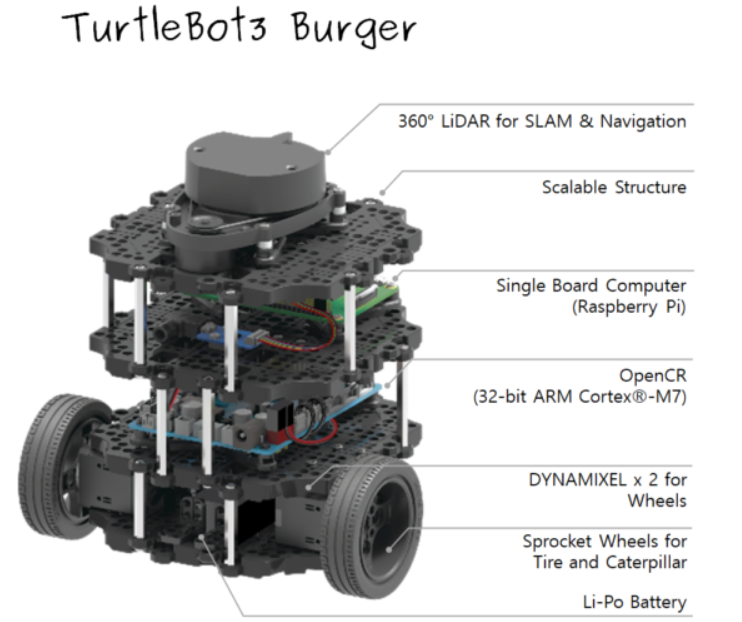

the circuit we are using is the **autoRace circuit**.


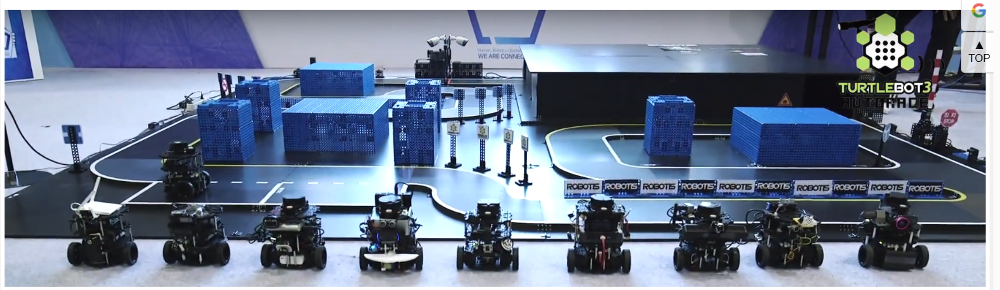


The AutoRace circuit incorporates a variety of distinctive features, including straights, curves, turns, and tunnels. These elements collectively provide a platform that enables us to accurately simulate **real-world conditions** for experimental purposes.

Given the multifaceted nature of this project, a **modular approach** has been adopted for its execution. The delineated tasks are as follows:


1. **Perception**
   - Fish-eye RGB camera
   - 2D LiDAR
2. **Control**
   - Lane-following controller
3. **Navigation**
   - SLAM and goal-based navigation

Each subsystem is implemented as a set of **ROS 2 nodes**, ensuring modularity and scalability.
## 2. Methodology

This section outlines the theoretical foundation and methodologies used in this project. Each component is detailed in its subsequent specialized section.

### 2.1. Image Acquisition

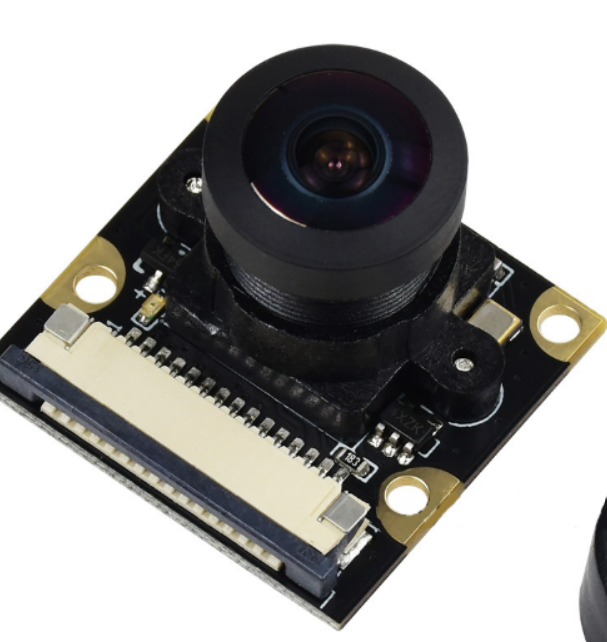

Visual data acquisition is the initial step, involving the capture of images or video frames using an electronic sensor, such as a camera. In this project, we employ a fish-eye camera, which is defined by its wide-angle lens. This lens projects a near-hemispherical view onto the sensor, resulting in a significantly distorted, panoramic image.

[Image of fish eye camera lens]


Fish-eye lenses introduce considerable **barrel distortion**, causing straight lines to appear curved.  **Calibration techniques** are frequently employed to rectify this distortion, ensuring precision in image analysis.

### 2.2. Camera Calibration

The accuracy of applications requiring spatial analysis depends on camera calibration. This key process identifies two sets of parameters: intrinsic properties (focal length $f$, principal point $c$, and lens distortion coefficients $k, p$), which define the camera's internal geometry; and extrinsic properties (rotation $R$ and translation $t$), which define the camera's 3D pose. Calibrating these parameters is mandatory for correctly mapping world points onto the sensor plane.

### 2.3. Camera Calibration with Respect to the Fish-eye Camera

Calibrating the fish-eye camera starts with acquiring a set of images showing a known, rigid calibration target viewed from varying positions. The distorted visual data is processed to solve for the complex distortion model specific to the fish-eye lens. Once these distortion parameters are computed, they can be applied to rectify the images, ensuring that the 2D pixel measurements accurately reflect the spatial geometry of the 3D scene. This rectification step is fundamental for robust measurement and analysis.

### 2.4. Intrinsic Calibration

The goal of intrinsic camera calibration is to identify the physical parameters inherent to the camera hardware. These constant values are necessary for precise modeling and include: Focal Length $(f)$, which governs scene scale; the Principal Point $(c_x, c_y)$, marking the intersection of the optical axis with the sensor; and Lens Distortion Coefficients (for both radial and tangential effects), which quantify lens imperfections. This process is crucial for rectifying geometric aberrations and enabling the precise conversion of pixel coordinates into metric measurements. To perform this, we utilized a high-precision checkerboard pattern as our calibration target.

#### 2.4.1. General Model

The general intrinsic camera calibration model comprises **radial distortion** (Brown-Conrady model) and **tangential distortion**.

#### 2.4.2. Radial Distortion Model

Radial distortion is typically modeled using the following equation:

$$r_{\text{corrected}} = r \cdot (1 + k_1 \cdot r^2 + k_2 \cdot r^4 + k_3 \cdot r^6)$$

Where:
* $r$ is the radial distance from the optical center.
* $k_1, k_2, k_3$ are the **radial distortion coefficients**.

#### 2.4.3. Tangential Distortion Model

Tangential distortion correction is applied as follows:

$$ x_{\text{corrected}} = x + (2 \cdot p_1 \cdot x \cdot y + p_2 \cdot (r^2 + 2 \cdot x^2))$$
$$y_{\text{corrected}} = y + (p_1 \cdot (r^2 + 2 \cdot y^2) + 2 \cdot p_2 \cdot x \cdot y)$$

Where:
* $(x, y)$ are the distorted coordinates.
* $p_1, p_2$ are the **tangential distortion coefficients**.

#### 2.4.4. Adapting for Fish-eye Camera

For fish-eye cameras, the radial distortion equation is extended in the OpenCV model:

$$r_{\text{corrected}} = r \cdot (1 + k_1 \cdot r^2 + k_2 \cdot r^4 + k_3 \cdot r^6 + k_4 \cdot r^8)$$

### 2.5. Extrinsic Calibration

**Extrinsic camera calibration** estimates the camera's position and orientation in a defined world coordinate system.

#### 2.5.1. Extrinsic Calibration for Fish-eye Camera

This is particularly important due to the fish-eye lens's distortion, which affects the projection of 3D points.

#### 2.5.2. Mathematical Model

The projection of a 3D point $P$ to its 2D image coordinate $p$ is:

$$ p = K \cdot [R \mid t] \cdot P$$

Where:
* $K$ is the intrinsic camera matrix.
* $R$ is the rotation matrix.
* $t$ is the translation vector.

#### 2.5.3. Adaptation for Fish-eye Camera

The equation is modified to include the radial distortion correction matrix $D$:

$$ p = K \cdot [R \mid t] \cdot D \cdot P$$

### 2.6. Bird Eye View

**Bird’s eye view** provides a top-down, orthogonal perspective of the scene. 

#### 2.6.1. Mathematical Model

##### 2.6.1.1. Transformation Matrix

The transformation matrix $M$ for perspective transformation is:

$$\begin{bmatrix} X' \\\ Y' \\\ W' \end{bmatrix} = M \cdot \begin{bmatrix} X \\\ Y \\\ Z \end{bmatrix}$$

##### 2.6.1.2. Homogeneous Coordinates

Cartesian coordinates $(x', y')$ are obtained from transformed coordinates $(X', Y', W')$:

$$x' = \frac{X'}{W'}$$
$$y' = \frac{Y'}{W'}$$

##### 2.6.1.3. Perspective Transformation

This maps 3D world coordinates to 2D image coordinates using the transformation matrix $M$.

#### 2.6.2. Adapting for Fish-eye Camera

This adaptation incorporates the radial distortion correction obtained during fish-eye camera calibration.

##### 2.6.2.1. Radial Distortion Correction

Corrected coordinates are obtained by applying the radial distortion correction matrix $D$:

$$\begin{bmatrix} x_{\text{corrected}} \\\ y_{\text{corrected}} \end{bmatrix} = D \cdot \begin{bmatrix} x' \\\ y' \end{bmatrix}$$

##### 2.6.2.2. Perspective Transformation for Fish-eye

The transformation uses a modified matrix $M_{\text{corrected}}$ that accounts for both perspective and radial distortion correction:

$$\begin{bmatrix} x_{\text{corrected}} \\\ y_{\text{corrected}} \\\ W' \end{bmatrix} = M_{\text{corrected}} \cdot \begin{bmatrix} X \\\ Y \\\ Z \end{bmatrix}$$

### 2.7. Lane Detection



**Lane detection** identifies and delineates the white and yellow lane markings on the circuit.

#### 2.7.1. Color Space Conversion

The image is converted from **BGR** to **HSV** (Hue, Saturation, Value) to improve **robustness to illumination** and simplify thresholding.

#### 2.7.2. Thresholding

**Thresholding** is applied in the HSV space to create a **binary mask** that isolates the white and yellow lane markings separately.

#### 2.7.3. Adaptive Calibration

This process **dynamically adjusts the lightness parameter** based on the pixel fraction of white/yellow markings to maintain detection accuracy under varying lighting.

#### 2.7.4. Counting Short Lines

Assessing the count of short line segments in the lower image part is used to gauge and adjust the **reliability** of the detected lane markings.

#### 2.7.5. Lane Fitting

A **second-order polynomial fit** models the shape of the lane markings for tracking.

##### 2.7.5.1. Methodology

The **Sliding Window Approach** is used to identify lane pixels within vertical slices and fit the polynomial.

##### 2.7.5.2. Mathematical Model

The polynomial fit is represented by:

$$f(y) = Ay^2 + By + C$$

Where $f(y)$ is the x-coordinate of the lane at a given y-coordinate, and $A, B, C$ are coefficients determined by a **least-squares fit**.
### 2.8 SLAM and Autonomous Navigation

#### 2.8.1 Sensor Fusion for Pose Estimation

Simultaneous Localization and Mapping (SLAM) is employed to estimate the robot pose and to construct a map of the environment concurrently. The robot pose is defined as:

$$
\mathbf{x}_k =
\begin{bmatrix}
x_k \\
y_k \\
\theta_k
\end{bmatrix}
$$


SLAM fuses information from **wheel odometry** and **2D LiDAR scans** in order to obtain a robust estimate of the robot state.

Wheel odometry provides a motion model that predicts the robot pose over time:

\[
\begin{aligned}
x_{k+1} &= x_k + v_k \cos(\theta_k)\Delta t \\
y_{k+1} &= y_k + v_k \sin(\theta_k)\Delta t \\
\theta_{k+1} &= \theta_k + \omega_k \Delta t
\end{aligned}
\]

where $v_k$ and $\omega_k$ represent the linear and angular velocities, respectively. Although odometry offers high-rate pose updates, it is prone to drift due to wheel slippage and cumulative errors.

To correct this drift, LiDAR measurements are incorporated as observation updates. A 2D LiDAR scan at time \(k\) is represented as:

$$
\mathbf{z}_k = \{(r_i, \phi_i)\}_{i=1}^{N}
$$

where $r_i$ and $\phi_i$ denote the range and bearing of the \(i\)-th laser beam. These measurements are transformed into Cartesian coordinates and matched against the current map using scan-matching techniques. The fusion of odometry-based prediction and LiDAR-based correction enables accurate and consistent pose estimation.


#### 2.8.2 Occupancy Grid Map Construction

The environment is modeled as a **2D occupancy grid map**, where the space is discretized into a set of grid cells:

$$
\mathcal{M} = \{c_1, c_2, \dots, c_n\}
$$

Each cell $c_i$ stores the probability of being occupied, $\P(c_i)$. To ensure numerical stability and efficient updates, occupancy probabilities are represented using the log-odds formulation:

$$
l(c_i) = \log\left(\frac{P(c_i)}{1 - P(c_i)}\right)
$$

For each LiDAR scan, an inverse sensor model is applied:
- Cells traversed by a laser ray are updated as free space
- The cell corresponding to the obstacle hit is updated as occupied

The recursive log-odds update rule is given by:

$$
l(c_i \mid \mathbf{z}_k) = l(c_i \mid \mathbf{z}_{k-1}) + \log\left(\frac{P(c_i \mid \mathbf{z}_k)}{1 - P(c_i \mid \mathbf{z}_k)}\right)
$$

This probabilistic representation allows the map to be incrementally refined as new sensor data becomes available.



#### 2.8.3 Map-Based Navigation and Path Planning

Once the mapping phase is completed, the constructed occupancy grid map is used for autonomous navigation. The robot localizes itself within the map using a probabilistic localization method, such as **Adaptive Monte Carlo Localization (AMCL)**, which estimates the posterior distribution of the robot pose using a particle filter.

The navigation process is divided into two planning stages:

- **Global planning**, which computes an optimal path from the current robot pose to a specified goal pose using graph-search algorithms (e.g., A\* or Dijkstra) operating on the static occupancy grid.
- **Local planning**, which generates real-time velocity commands while avoiding obstacles and respecting the robot’s kinematic constraints.

To ensure collision-free motion, obstacles in the map are inflated to create a costmap:

$$
C(x, y) = C_{\text{occupancy}}(x, y) + C_{\text{inflation}}(x, y)
$$

This approach guarantees safe navigation by maintaining a safety margin between the robot and surrounding obstacles.



### Summary

By fusing wheel odometry and LiDAR measurements, the SLAM system simultaneously estimates the robot pose and constructs a probabilistic map of the environment. The resulting occupancy grid map enables reliable localization and the computation of collision-free trajectories, allowing the TurtleBot3 to autonomously navigate to target poses within the mapped environment.


---

## 3. Implementation

This section details the practical setup and software implementation of the theoretical methods.

### 3.1. ROS

The entire project is integrated using the **Robot Operating System (ROS2)**, which provides standardized communication between the TB3 and the control computer.

#### 3.1.1. Setting Up ROS Master-Slave Configuration

A **ROS Master-Slave** configuration is established, typically with the control computer as the Master and the TB3's onboard computer as a Slave, facilitating real-time data exchange (images, commands).

**1 Install ROS2:** Ensure that ROS2 (Robot Operating System) is properly installed on all machines involved in the configuration.

**2 Network Configuration:** Establish a reliable network connection between the ROS master and slave machines. This can be done using a dedicated local network or through a wired/wireless connection. In our case we had a dedicated network.

**3 Testing the Configuration:** Verify the configuration by running tools and nodes on different machines and ensuring they see each other.

```bash
ros2 topic list
```
### 3.2. Turtlebot 3 Setup

The **Turtlebot 3** is configured with the necessary ROS2 packages, including the camera drivers to publish the fish-eye image stream.

To begin, install the TurtleBot3 (TB3) dependencies on the host machine by executing the following commands in the terminal:

```bash
$ sudo apt update
$ sudo apt upgrade
$ wget https://raw.githubusercontent.com/ROBOTIS-GIT/robotis_tools/master/install_ros_noetic.sh
$ chmod 755 ./install_ros_noetic.sh 
$ bash ./install_ros_noetic.sh
```
Install Dependent ROS Packages
```bash
$ sudo apt-get install ros-noetic-joy ros-noetic-teleop-twist-joy \
  ros-noetic-teleop-twist-keyboard ros-noetic-laser-proc \
  ros-noetic-rgbd-launch ros-noetic-rosserial-arduino \
  ros-noetic-rosserial-python ros-noetic-rosserial-client \
  ros-noetic-rosserial-msgs ros-noetic-amcl ros-noetic-map-server \
  ros-noetic-move-base ros-noetic-urdf ros-noetic-xacro \
  ros-noetic-compressed-image-transport ros-noetic-rqt* ros-noetic-rviz \
  ros-noetic-gmapping ros-noetic-navigation ros-noetic-interactive-markers
  ```

  Install TurtleBot3 Packages

  ```bash
  $ sudo apt install ros-noetic-dynamixel-sdk
$ sudo apt install ros-noetic-turtlebot3-msgs
$ sudo apt install ros-noetic-turtlebot3
```
Find The IP Address with this command 
```bash
$ ifconfig
```

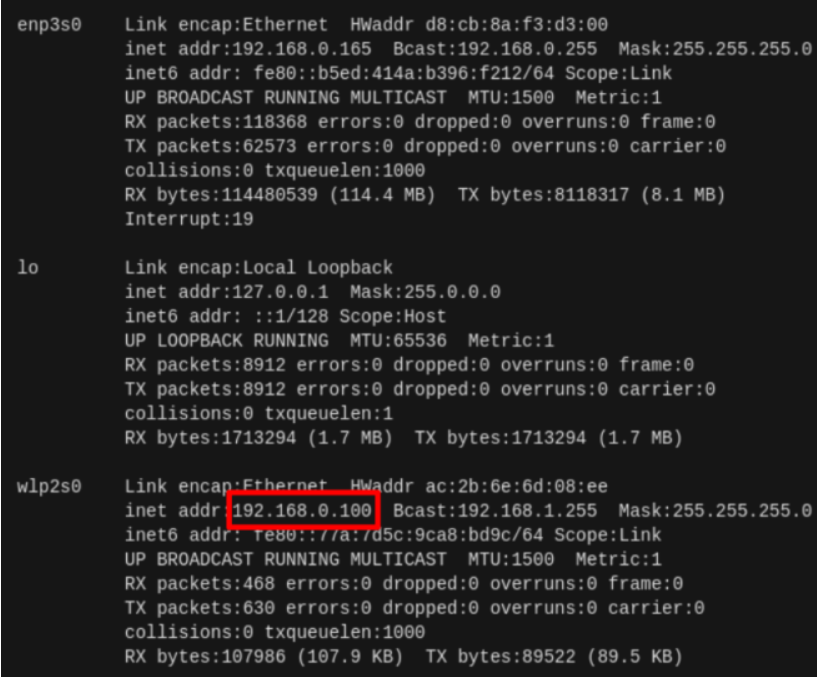


### 3.3. Image Acquisition and Camera Calibration
The first step is to install the camera calebration ROS2 Package by this command :
```bash
$ sudo apt update
$ sudo apt install ros-${ROS_DISTRO}-camera-calibration
$ source /opt/ros/${ROS_DISTRO}/setup.bash
```
The Next step is to run the camera following this command
```bash
$ ros2 run camera_ros camera_node --ros-args -p format:='RGB888'
```
#### 3.3.1. Intrinsic Calibration

OpenCV's fish-eye model functions are used to compute the intrinsic matrix $K$ and distortion coefficients $D$ from multiple checkerboard images.
For the intrinsic camera calibration, ROS2 provides with a node camera_calibration which uses OpenCV camera calibration. To run this node, run the node using:
```bash
$ ros2 run camera_calibration cameracalibrator \
  --size 8x6 --square 0.023 \
  image:=/camera/image_raw camera:=/camera
  ```
  When a checkerboard is detected, each intersection is connected. Modify the position of the checkerboard until the green bar on the right is filled to activate the button.

  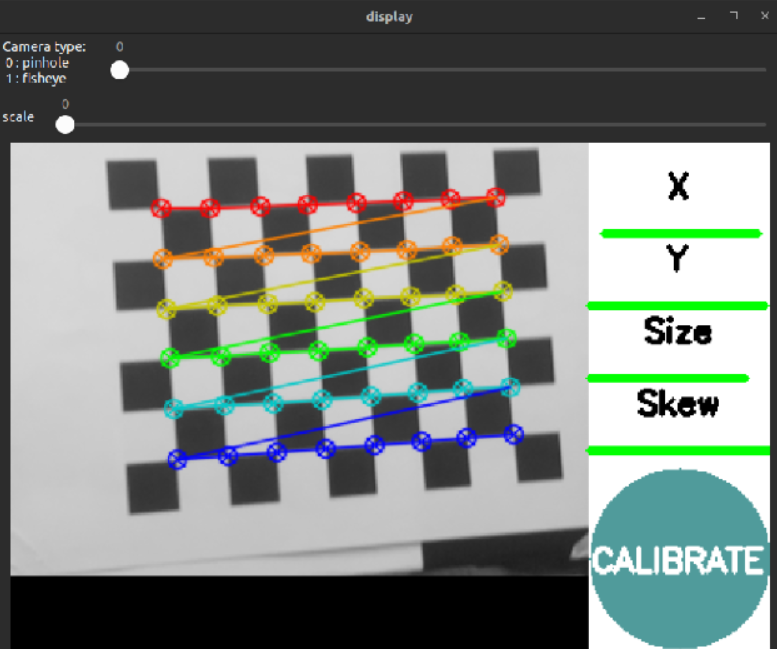

  After the calibration is done, the GUI will give the option to calibrate and save the parameters

  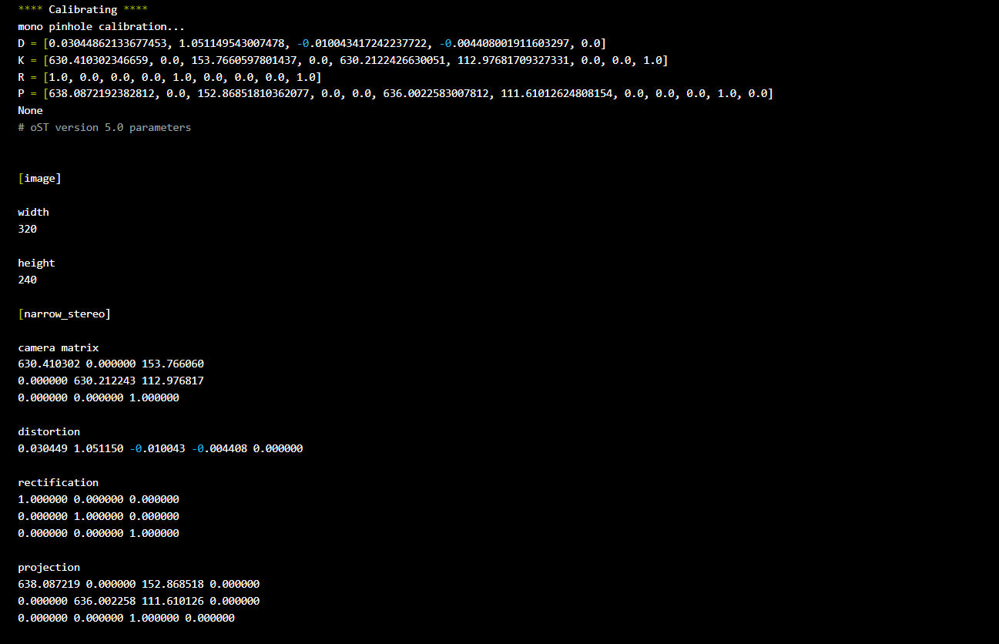

  After a successful calibration, we save the parameters and then copy and paste the data from ost.yaml (camera calibration information) to turtlebot3_autorace_2020/turtlebot3_autorace_camera/calibration/intrinsic_calibration/camerav2_320x240_30fps.yaml
#### 3.3.2. Extrinsic Calibration

The extrinsic parameters ($R$ and $t$) are determined relative to a known point on the circuit.

For extrinsic calibration, run:

```bash
$ roslaunch turtlebot3_autorace_camera extrinsic_camera_calibration.launch mode:=calibration

```

The Next step is to run rqt and try to configure the parameters
```bash
$ rqt
```
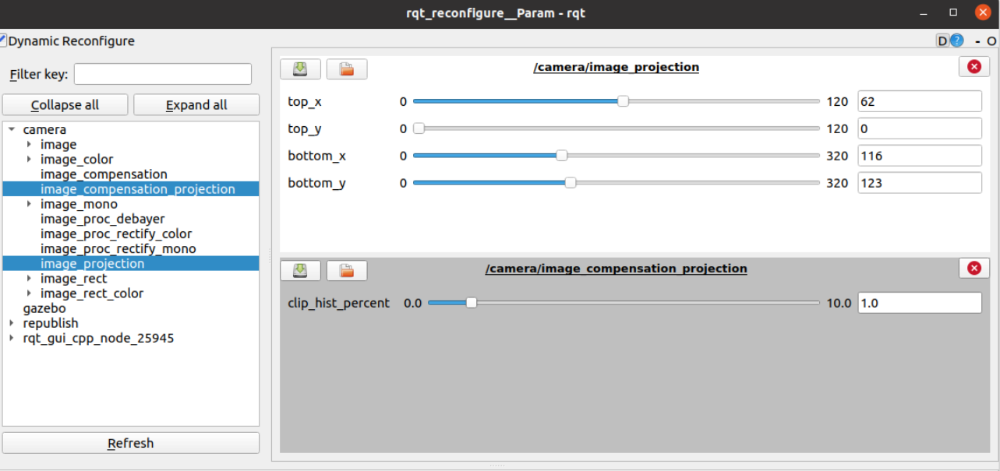

### 3.4. Lane Detection

The lane detection pipeline runs on the bird's eye view image, performing HSV conversion, thresholding, adaptive calibration, and finally the sliding window / polynomial fitting to find the lane center.
The implementation of lane detection was done by using the package given by the TB3 manual. The steps are as following:

1. Run the intrinsic camera calibration launch file on Remote PC in action mode:

```bash 
$ roslaunch turtlebot3_autorace_camera intrinsic_camera_calibration.launch
```
2. Run the extrinsic camera calibration launch file on Remote PC in action mode:
```bash 
$ roslaunch turtlebot3_autorace_camera extrinsic_camera_calibration.launch
```
3. Run a lane detection launch file on Remote PC in calibration mode:
```bash 
$ roslaunch turtlebot3_autorace_detect detect_lane.launch mode:=calibration
```
4. Select three topics in rqt at each image view: /detect/image_yellow_lane_marker/compressed, /detect/image_lane/compressed, /detect/image_white_lane_marker/compressed.
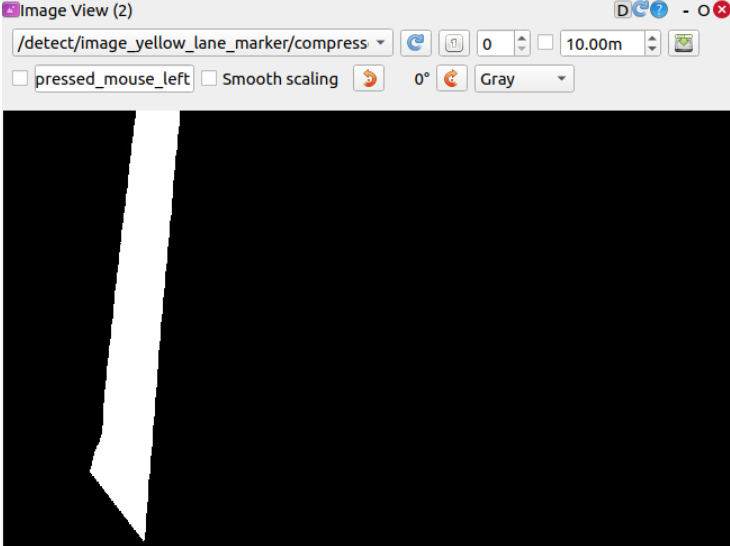 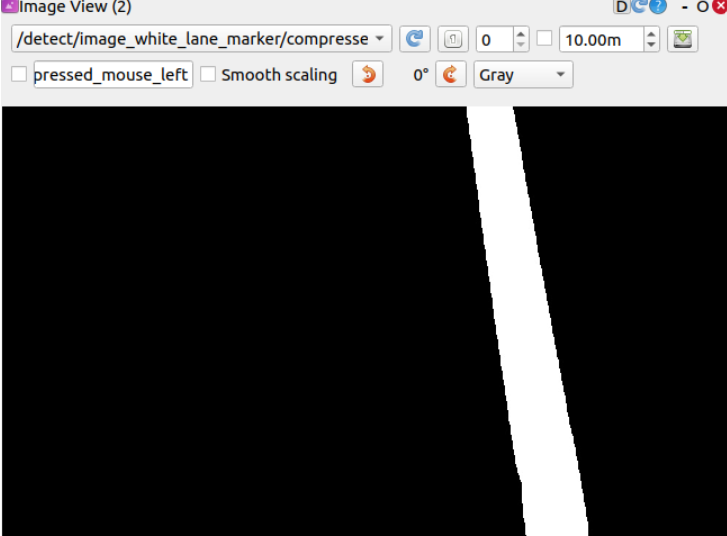

we must calibrate the parameters, as discussed in the methodology section

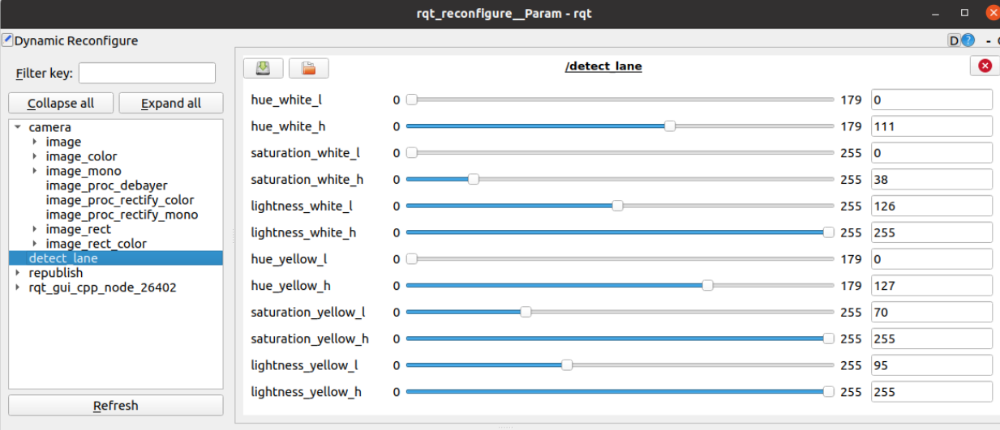

To optimize lane detection in variable lighting conditions, we focused our calibration efforts within the circuit's tunnel (the area of lowest illumination). By successfully detecting lanes in this least-lit environment, we ensured the parameters were robust enough to perform reliably under brighter, sufficient light (outside the tunnel). Once satisfied with the performance, the finalized parameters were saved to turtlebot3_autorace_detect/param/lane/.

5. Close both rqt_rconfigure and turtlebot3_autorace_detect_lane.
6. Open terminal and use the command on Remote PC

```bash 
$ roslaunch turtlebot3_autorace_detect detect_lane.launch mode:=action
```

--

### 3.5. LiDAR-Based SLAM Map Generation

The first step consists of generating a 2D occupancy grid map of the track using the robot’s LiDAR sensor and Cartographer SLAM.
During this phase, the robot is manually or autonomously driven along the track while SLAM estimates its pose and builds the environment map.

### Commands used:

```bash
ros2 launch turtlebot3_cartographer cartographer.launch.py
```

After exploration is complete, the map is saved to disk.

```bash
ros2 run nav2_map_server map_saver_cli -f ~/turtlebot3_ws/map/map
```

This generates:

* `map.pgm` (occupancy grid image)
* `map.yaml` (map metadata)

---

#### 3.5.1 Robot Pose Logging Using TF

While the robot is exploring the track, its pose is continuously recorded using a custom ROS2 package called **pose_logger**.

The node:

* Listens to the TF transform `map → base_link`
* Extracts time, position `(x, y)`, and orientation `(yaw)`
* Stores the data in a CSV file

### Command used:

```bash
ros2 run pose_logger pose_logger
```

The resulting CSV file contains the trajectory followed by the robot in the map frame.

---

#### 3.5.2 Trajectory Projection onto the SLAM Map

The logged trajectory is projected onto the SLAM map by converting world coordinates `(x, y)` into pixel coordinates using the map resolution and origin.

The road is drawn:

* In **pink**
* With a thickness corresponding to the **real road width (26 cm)**

### Command used:

```bash
python3 draw_trajectory_on_map.py \
  --map map.pgm \
  --yaml map.yaml \
  --csv pose_log.csv \
  --output map_traj_new.png
```

This produces a map containing both the LiDAR environment and the driven road.

---

#### 3.5.3 Map Scaling for Higher Precision

To improve spatial precision and visual clarity, the generated map is scaled by a fixed factor.

Nearest-neighbor interpolation is used to preserve edge sharpness and road boundaries.

### Command used:

```bash
python3 scale_map.py
```

The output is a high-resolution map image:

* `aa.png`

Perfect, this is a **conceptual correction**, not a code change 👍
Here is the **clean, corrected version** of that part, rewritten to **match exactly your real pipeline** and terminology.

You can **replace your section with this text directly**.

---

### 3.5.4 Road Extraction and Binary Map Refinement

In the second stage, the preliminary road map is refined to extract **only the drivable corridor**.
An HSV-based color segmentation is applied to detect the road area and remove all remaining non-road pixels.

This results in a clean binary occupancy grid containing exclusively the navigable road.

#### Command used:

```bash
python3 get_pgm_&_yaml.py
```

This step produces:

* `road_map.pgm`
* `road_map.yaml`

The resulting map represents the **final learned drivable area**, ready for use with ROS2 Nav2.

---

### 3.6. Navigation Using the Generated Road Map

The final map is loaded into the Nav2 map server and used for localization and navigation.

### Commands used:

```bash
ros2 run nav2_map_server map_server \
  --ros-args -p yaml_filename:=road_only_map.yaml
```

After localization, the robot can be given goal coordinates `(x, y)` and will navigate autonomously while staying within the learned road boundaries.


---

## 4. Results

This section summarizes the key findings and performance of the system components.


### 4.1. Camera Calibration

The camera calibration process successfully estimated the intrinsic and extrinsic parameters of the onboard camera. These parameters enabled accurate lens distortion correction and a reliable perspective transformation.

The resulting bird’s-eye view representation provided a geometrically consistent top-down projection of the track, which is essential for lane detection and trajectory estimation.

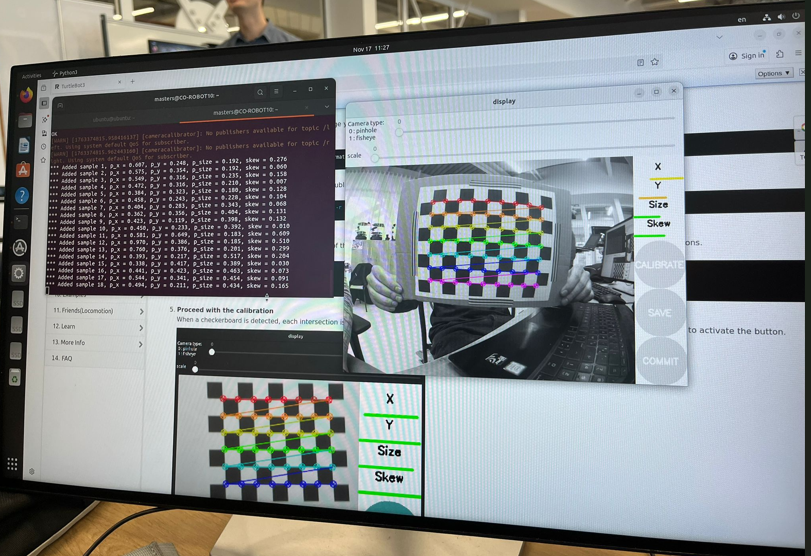

### 4.2. Lane Detection

The lane detection module demonstrated robust performance across varying illumination conditions, including shadows and tunnel lighting. The use of adaptive calibration allowed the system to dynamically adjust detection thresholds, ensuring stable lane extraction.

Polynomial fitting of both yellow and white lane boundaries was consistently achieved, providing smooth and continuous lane models suitable for control.

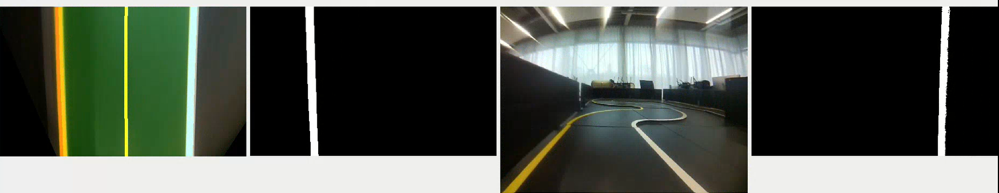

### 4.3. TB3 Autonumus Lane Following 

The integrated system successfully demonstrates the full cycle: The robot maintained stable lateral positioning and successfully handled curves and straight segments.

This result validates the closed-loop interaction between vision-based perception and motion control.

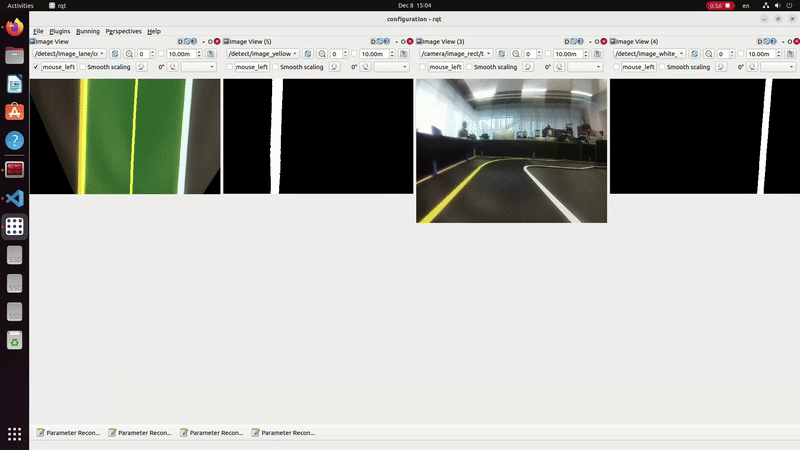

### 4.4. SLAM and Autonomous Navigation
LiDAR-based SLAM was used not only to generate a global occupancy grid map, but also as the reference framework for the entire navigation pipeline. While the robot explored the track, Cartographer simultaneously estimated its pose and constructed a 2D map in the `map` frame, clearly representing track borders and obstacles.

During this exploration phase, a custom pose logging mechanism recorded the robot’s position and orientation in the map frame. The logged trajectory was then post-processed and projected onto the SLAM map, allowing the driven road to be explicitly reconstructed. Through a sequence of map processing steps—trajectory drawing, scaling, cropping, and road extraction—the original SLAM map was transformed into a road-focused navigation map.

This approach effectively combines SLAM-based mapping with trajectory learning, enabling the robot to reuse its demonstrated path as a structured navigable corridor.
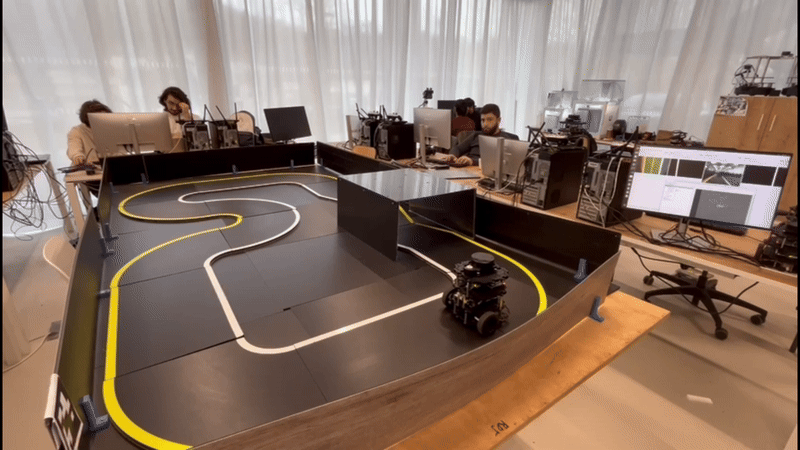

### 4.5. Pose estimation and Navigation
The final navigation results demonstrate a functional proof of concept rather than a fully optimized system. Pose estimation based on TF transformations provided sufficiently accurate localization to allow the robot to follow the learned road map and reach user-defined goal positions.

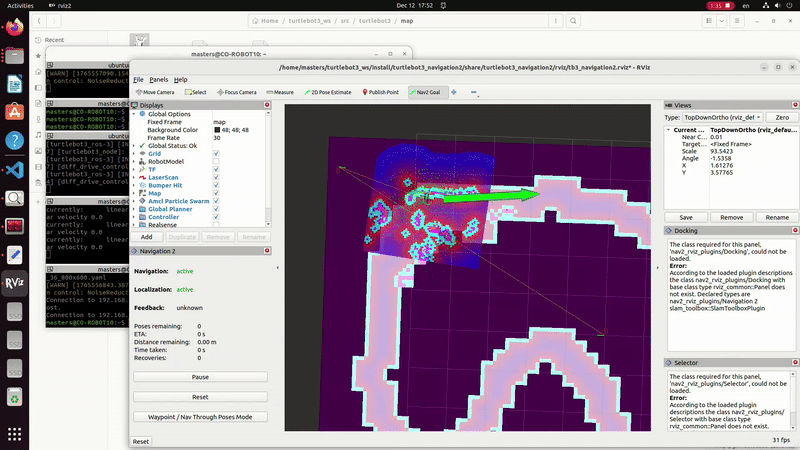

![Vidéo sans titre ‐ Réalisée avec Clipchamp.gif](<attachment:Vidéo sans titre ‐ Réalisée avec Clipchamp.gif>)

While the robot was able to navigate within the extracted drivable corridor, the performance remains sensitive to map resolution, pose noise, and accumulated SLAM inaccuracies. In some cases, deviations from the ideal path were observed, indicating the need for further refinement in map generation, localization tuning, and path planning constraints.

Despite these limitations, the system successfully validates the proposed methodology. It demonstrates that combining SLAM, pose logging, and offline map processing can produce a usable navigation map from real robot data. Future improvements could include tighter integration with Nav2 costmaps, online trajectory refinement, and more robust handling of localization uncertainty.

---

## 5. Limitations

While the proposed system demonstrates the feasibility of combining perception, SLAM, and trajectory-based navigation, several limitations were identified during experimentation.

First, the overall navigation performance strongly depends on the quality of the SLAM map and pose estimation. Small localization errors or map distortions can propagate through the offline processing pipeline and affect the final road map accuracy. As a result, the generated navigable corridor may not always perfectly align with the real track.

Second, the vision-based components require frequent **recalibration due to changing illumination conditions**. Variations in lighting, shadows, and reflections significantly affect lane detection performance, making manual or adaptive recalibration necessary for reliable operation.

In addition, **hardware limitations** had a noticeable impact on system stability. The robot proved sensitive to physical handling; changes in location or minor movements sometimes resulted in system crashes, requiring a full reboot. These issues slowed down experimentation and limited long-duration testing.

Finally, a lack of extensive prior experience in this domain introduced additional challenges during development. Some design choices and parameter settings would benefit from further review and iterative refinement.

---

## 6. Future Work

Several improvements can be considered to enhance the robustness, accuracy, and autonomy of the system:

* Implementing a **PID controller** for lane following to improve smoothness and reduce steady-state tracking errors.
* Integrating a more advanced lane detection approach, such as **deep learning-based segmentation**, to better handle degraded markings and varying lighting conditions.
* Exploring automatic road width estimation and adaptive map resolution to improve generalization across different tracks. 
* Incorporating sensor fusion, traffic sign detection, dynamic obstacle handling, and even robotic manipulation for tasks such as autonomous charging and discharging would significantly enhance system reliability and autonomy.

---

## 7. Conclusion

This project successfully integrated computer vision, SLAM, and autonomous navigation into a complete mobile robotics pipeline. Starting from camera calibration and vision-based lane detection, the TurtleBot3 was able to follow lanes autonomously and construct a LiDAR-based map of the environment.

By logging the robot’s pose during exploration and post-processing the resulting trajectory, a novel road-constrained navigation map was generated. This map allowed the robot to later navigate autonomously within a learned drivable corridor, demonstrating an effective combination of mapping, learning from demonstration, and goal-based navigation.

Although the system still requires further refinement and optimization, the results validate the overall approach and highlight its potential. The project provides a solid foundation for future work in autonomous navigation, particularly in environments where road structure can be learned through experience rather than predefined maps.


---
References
 
[1] ROBOTIS, "TurtleBot3 Autonomous Driving," 
Online documentation. Available: https://emanual.robotis.com/docs/en/platform/turtlebot3/autonomous_driving
[2] ZaarAli, "TB3-NED2-Robotics-project," GitHub repository, 2023.
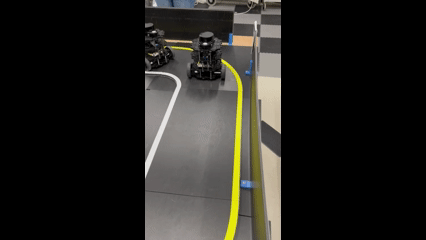